# Energy Preserving Operator Inference Optimization Example using Periodic BC Burger's Equation

In this notebook, we conduct the numerical experiment for the energy-preserving Operator Inference (ep-OpInf) for both the hard equality constraint and soft inequality constraint.

## Packages

In [1]:
using CSV
using DataFrames
using FileIO
using JLD2
using LaTeXStrings
using LinearAlgebra
using NaNStatistics
using Plots
using ProgressMeter
using Random
using SparseArrays
using Statistics
using Tables
;

## Initial Setup

In [2]:
include("../src/model/Burgers.jl")
include("../src/LiftAndLearn.jl")
const LnL = LiftAndLearn
;

In [3]:
# First order Burger's equation setup
burger = Burgers(
    [0.0, 1.0], [0.0, 1.0], [0.05, 0.15],
    2^(-7), 1e-4, 6, "periodic"
)
;

In [4]:
# Create file name to save data
filename = "data/epOpInf_periodic_data_test3.jld2"
;

### Important Parameters

In [5]:
# Minimum and maximum dimensions
rmin = 1
rmax = 10

burger_system = LnL.sys_struct(
    is_lin=true,
    is_quad=true,
)
burger_vars = LnL.vars(
    N=1,
)
burger_data = LnL.data(
    Δt=1e-4,
    DS=100,
)
burger_optim = LnL.opt_settings(
    verbose=false,
    initial_guess=false,
    max_iter=1000,
    reproject=false,
    SIGE=true,
)

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Downsampling rate
DS = burger_data.DS

# Down-sampled dimension of the time data
Tdim_ds = size(1:DS:burger.Tdim, 1)  # downsampled time dimension

# Number of random test inputs
num_test_ic = 10
;

### Initial Conditions

A complex wave with a combination of exponential, cosine, and sine waves.

$$
\begin{gather*}
    x(\omega, 0) = \exp\left(-a\cos^2(\pi\omega+b) + \sin^2\left(4\pi\omega+\frac{\pi}{3}\right)+\cos^2(3\pi\omega) \right)+c
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.

In [ ]:
# Parameters for the initial condition
ic_a = [1, 5, 9]
ic_b = [-π/4, 0, π/4]
ic_c = [-0.5, 0, 0.5]
ic_a_out = [0.01, 1]
ic_b_out = [-π/2, π/2]
ic_c_out = [-1.0, 1.0]
num_ic_params = Int(length(ic_a)*length(ic_b)*length(ic_c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(π .* burger.x .+ b).^2 .+ sin.(4*π .* burger.x + π/3).^2 .- cos.(3*π .* burger.x).^2) .+ c
;

A combination of exponential and cosine initial condition:


$$
\begin{gather*}
    x(\omega, 0) = \exp(-a\cos^2(\pi x+b)) - c
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.

In [6]:
# Parameters for the initial condition
ic_a = [2, 4, 6]
ic_b = [-0.5, 0, 0.5]
ic_c = [-0.25, 0, 0.25]
ic_a_out = [0.1, 8]
ic_b_out = [-0.8, 0.8]
ic_c_out = [-0.5, 0.5]
num_ic_params = Int(length(ic_a)*length(ic_b)*length(ic_c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(π .* burger.x .+ b).^2) .- c
;

Initial condition to sinusoidal wave with three parameters: amplitude ($A$), frequency ($a$), and phase ($b$)

$$
\begin{gather*}
    x(\omega, 0) = A\sin(2\pi f\omega + \phi)
\end{gather*}
$$

For the convenience of code, we designate the variables $a = A$, $b = f$, and $c = \phi$.

In [6]:
# Parameters of the initial condition
ic_a = [0.8, 1.0, 1.2]
ic_b = [1, 2, 3]
ic_c = [-0.5, 0, 0.5]
num_ic_params = Int(length(ic_a) * length(ic_b) * length(ic_c))

# Parameterized function for the initial condition
init_wave = (A,a,b) -> A .* sin.(2 * pi * a * burger.x .+ b) 
;  

## Generate Training Data

In [7]:
# Store values
Xtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training state data 10x1
Rtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training derivative data 10x1
Xtr_all = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_ic_params)  # all training data 10x27
IC_train = Vector{Vector{Float64}}(undef, num_ic_params)  # all initial conditions 
Vrmax = Vector{Matrix{Float64}}(undef, burger.Pdim)  # POD basis 10x1
op_fom_tr = Vector{LnL.operators}(undef, burger.Pdim)  # FOM operators 10x1

@info "Generate the FOM system matrices and training data."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A, F = burger.generateEPmatrix(burger, μ)
    op_fom_tr[i] = LnL.operators(A=A, F=F)

    # Store the training data 
    Xall = Vector{Matrix{Float64}}(undef, num_ic_params)
    Xdotall = Vector{Matrix{Float64}}(undef, num_ic_params)
    
    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for a in ic_a, b in ic_b, c in ic_c
        if i == 1
            IC_train[ct] = init_wave(a, b, c)
        end

        states = burger.semiImplicitEuler(A, F, burger.t, IC_train[ct])
        Xtr_all[i,ct] = states
        
        tmp = states[:, 2:end]
        Xall[ct] = tmp[:, 1:DS:end]  # downsample data
        tmp = (states[:, 2:end] - states[:, 1:end-1]) / burger.Δt
        Xdotall[ct] = tmp[:, 1:DS:end]  # downsample data

        ct += 1  # increment counter
    end
    # Combine all initial condition data to form on big training data matrix
    Xtr[i] = reduce(hcat, Xall) 
    Rtr[i] = reduce(hcat, Xdotall)
    
    # Compute the POD basis from the training data
    tmp = svd(Xtr[i])
    Vrmax[i] = tmp.U[:, 1:rmax]
end

Data = Dict("Xtr" => Xtr, "Rtr" => Rtr, "Vrmax" => Vrmax, 
        "op_fom_tr" => op_fom_tr, 
        "Xtr_all" => Xtr_all, "IC_train" => IC_train)
@save filename Data

┌ Info: Generate the FOM system matrices and training data.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:9


Progress:  33%|██████████████                           |  ETA: 1:01:12

Progress:  50%|█████████████████████                    |  ETA: 0:46:19

Progress:  67%|████████████████████████████             |  ETA: 0:31:03

Progress:  83%|███████████████████████████████████      |  ETA: 0:15:36

Progress: 100%|█████████████████████████████████████████| Time: 1:33:59


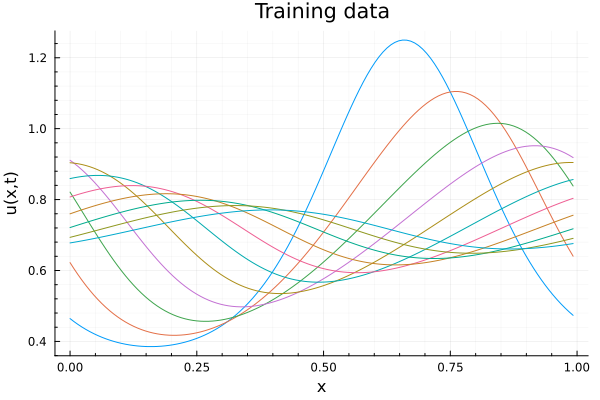

In [19]:
p1 = plot()
for i in 1:1000:burger.Tdim
    plot!(p1, burger.x, Xtr_all[1,1][:, i])
end
plot!(p1, xlabel="x", ylabel="u(x,t)", title="Training data", grid=true,
    minorgrid=true, legend=false)

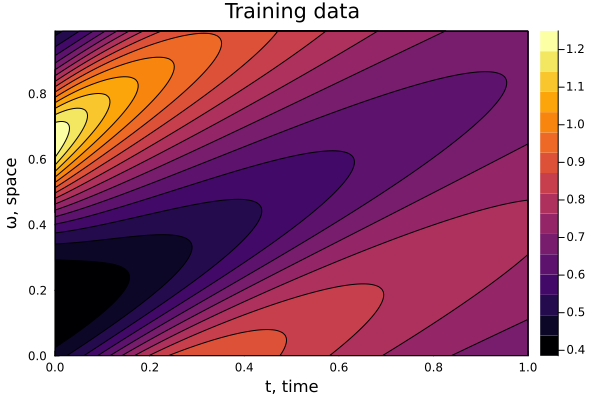

In [18]:
plot(contour(burger.t, burger.x, Xtr_all[1,1], fill=true), xlabel="t, time", ylabel="ω, space", zlabel="u(x,t)", title="Training data")

## Generate Test Data (Inside Training Region)

10 random amplitude, frequency, and phase from the training region for $\mu \in M$.


In [54]:
# Store values
Xtest_in = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_in = Vector{Vector{Float64}}(undef, num_test_ic)  # all initial conditions

@info "Generate test data for parameters within the training region."

# Generate 10 random amplitude, frequency, and phase values
# AMP_test = (maximum(AMP) - minimum(AMP)) .* rand(num_test_ic) .+ minimum(AMP)
# FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
# PHASE_test = (maximum(PHASE) - minimum(PHASE)) .* rand(num_test_ic) .+ minimum(PHASE)

# Generate 10 random initial condition parameters
ic_a_rand_in = (maximum(ic_a) - minimum(ic_a)) .* rand(num_test_ic) .+ minimum(ic_a)
ic_b_rand_in = (maximum(ic_b) - minimum(ic_b)) .* rand(num_test_ic) .+ minimum(ic_b)
ic_c_rand_in = (maximum(ic_c) - minimum(ic_c)) .* rand(num_test_ic) .+ minimum(ic_c)

@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate the data for all combinations of the initial condition parameters
    for j in 1:num_test_ic  
        a = ic_a_rand_in[j]
        b = ic_b_rand_in[j]
        c = ic_c_rand_in[j]

        if i == 1
            IC_test_in[j] = init_wave(a, b, c)
        end
        Xtest_in[i,j] = burger.semiImplicitEuler(A, F, burger.t, IC_test_in[j])
    end
end

Data["Xtest_in"] = Xtest_in
Data["IC_test_in"] = IC_test_in
@save filename Data

┌ Info: Generate test data for parameters within the training region.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:5


Progress:  33%|██████████████                           |  ETA: 0:22:52

Progress:  50%|█████████████████████                    |  ETA: 0:17:08

Progress:  67%|████████████████████████████             |  ETA: 0:11:24

Progress:  83%|███████████████████████████████████      |  ETA: 0:05:42

Progress: 100%|█████████████████████████████████████████| Time: 0:34:09


## Generate Test Data (Outside Training Region)

10 random amplitude, frequency, and phase outside of the training region for $\mu \in M$.



In [57]:
# Store values
Xtest_out = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_out = Vector{Vector{Float64}}(undef, num_test_ic)  # all initial conditions

@info "Generate test data for parameters outside the training region."

# Generate 10 random amplitude, frequency, and phase values
# AMP_test = (minimum(AMP) - 0.2) .* rand(num_test_ic/2) .+ 0.2
# append!(AMP_test, (1.8 - maximum(AMP)) .* rand(num_test_ic/2) .+ maximum(AMP))
# FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
# PHASE_test = (minimum(PHASE) - 1.0) .* rand(num_test_ic/2) .- 1.0
# append!(PHASE_test, (1.0 - maximum(PHASE)) .* rand(num_test_ic/2) .+ maximum(PHASE))

# Generate 10 random initial condition parameters outside the training region
ϵ=1e-2
half_num_test_ic = Int(num_test_ic/2)
ic_a_rand_out = ((minimum(ic_a) - ϵ) - ic_a_out[1]) .* rand(half_num_test_ic) .+ ic_a_out[1]
append!(ic_a_rand_out, (ic_a_out[2] - (maximum(ic_a) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_a) + ϵ))
ic_b_rand_out = ((minimum(ic_b) - ϵ) - ic_b_out[1]) .* rand(half_num_test_ic) .+ ic_b_out[1]
append!(ic_b_rand_out, (ic_b_out[2] - (maximum(ic_b) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_b) + ϵ))
ic_c_rand_out = ((minimum(ic_c) - ϵ) - ic_c_out[1]) .* rand(half_num_test_ic) .+ ic_c_out[1]
append!(ic_c_rand_out, (ic_c_out[2] - (maximum(ic_c) + ϵ)) .* rand(half_num_test_ic) .+ (maximum(ic_c) + ϵ))

@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate the data for all combinations of the initial condition parameters
    for j in 1:num_test_ic
        a = ic_a_rand_out[j]
        b = ic_b_rand_out[j]
        c = ic_c_rand_out[j]

        if i == 1
            IC_test_out[j] = init_wave(a, b, c)
        end
        Xtest_out[i,j] = burger.semiImplicitEuler(A, F, burger.t, IC_test_out[j])
    end
end

Data["Xtest_out"] = Xtest_out
Data["IC_test_out"] = IC_test_out
@save filename Data

┌ Info: Generate test data for parameters outside the training region.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:5


Progress:  33%|██████████████                           |  ETA: 0:22:06

Progress:  50%|█████████████████████                    |  ETA: 0:16:37

Progress:  67%|████████████████████████████             |  ETA: 0:11:05

Progress:  83%|███████████████████████████████████      |  ETA: 0:05:33

Progress: 100%|█████████████████████████████████████████| Time: 0:33:13


## Obtain OpInf Least-Squares Operators

In [8]:
@info "Compute the Least Squares solution."

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    pinv_tol = 1e-4,          # tolerance for pseudo-inverse
)

# Store values
op_LS = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    @info "Data loaded."
end

@showprogress for i in 1:length(burger.μs)
    op_LS[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
end

# Save to data
Data["op_LS"] = op_LS
save(filename, Data)

┌ Info: Compute the Least Squares solution.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


Progress:  33%|██████████████                           |  ETA: 0:00:10

┌ Warning: Rank difficient, rank = 65, tol = 9.829780731607959e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 64, tol = 7.008834094144342e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 63, tol = 7.39783343144969e-5.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress: 100%|█████████████████████████████████████████| Time: 0:00:04


## Obtain intrusive operators 

In [9]:
@info "Compute the intrusive model"

# Store values
op_int = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Vrmax = Data["Vrmax"]
    op_fom_tr = Data["op_fom_tr"]
    @info "Data loaded."
end

for i in 1:length(burger.μs)
    # Compute the values for the intrusive model from the basis of the training data
    op_int[i] = LnL.intrusiveMR(op_fom_tr[i], Vrmax[i], options)
    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_int"] = op_int
save(filename, Data)

┌ Info: Compute the intrusive model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 5 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21


## Obtain operators for EPHEC-OpInf

In [10]:
@info "Compute the EPHEC model"

options = LnL.EPHEC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from data file..."
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# for i in 1:length(burger.μs)
#     if test == 1
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_tmp = LnL.operators()
#         for j in rmin:rmax
#             if j == rmin
#                 options.optim.initial_guess = false
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options)
#             else
#                 options.optim.initial_guess = true
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, op_tmp)
#             end

#             if j != rmax
#                 op_tmp.A = [op_tmp.A zeros(j, 1); zeros(1, j+1)]
#                 op_tmp.F = Matrix(LnL.insert2F(op_tmp.F, j+1))
#             else
#                 op_ephec_opinf[i] = op_tmp
#             end
#         end
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_ephec = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_ephec[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_ephec[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_ephec[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_ephec"] = op_ephec
save(filename, Data)

┌ Info: Compute the EPHEC model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141



******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************



┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 1
│ solve time           = 0.12000012397766113
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 654.6120139446087
│ objective_value      = 582.2560362610124
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 2
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 45823.972346947965
│ objective_value      = 20539.84593924492
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91489.45697100424
│ objective_value      = 442.35520594927317
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 115766.9579135637
│ objective_value      = 1463.8413177980913
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 138634.98828198048
│ objective_value      = 59.517305647384745
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 146613.81611316864
│ objective_value      = 91.20961400478546
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151374.04531512185
│ objective_value      = 4.536997357030161
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.018000125885009766
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 152723.1843505991
│ objective_value      = 7.857029796583372
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153715.66127614956
│ objective_value      = 0.2177104146377762
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.013000011444091797
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153897.82407230107
│ objective_value      = 0.32384921421560414
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpIn

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91155.22593843339
│ objective_value      = 383.3530667691389
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Opt

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 118263.84645393745
│ objective_value      = 908.530492283308
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 142315.0668103715
│ objective_value      = 35.734327592326835
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151276.85604718266
│ objective_value      = 42.88516538649581
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.0029997825622558594
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 154822.95569708507
│ objective_value      = 2.634981152455708
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.019999980926513672
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156304.74257043088
│ objective_value      = 3.4499309795099657
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.00800013542175293
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157101.14383666762
│ objective_value      = 0.07280233638319694
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.024000167846679688
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157268.73553755644
│ objective_value      = 0.09436651157968193
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpIn

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.005000114440917969
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 96787.10783579679
│ objective_value      = 369.68418229781173
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.008999824523925781
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 129350.73757389243
│ objective_value      = 696.9503364934234
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156143.3151600921
│ objective_value      = 30.434319298056693
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 166574.85252430142
│ objective_value      = 25.602730519719035
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 169592.4795814531
│ objective_value      = 2.2651102985237452
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.005000114440917969
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 171360.4928135048
│ objective_value      = 2.241335645148636
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.03699994087219238
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172122.96054175185
│ objective_value      = 0.03309683580561437
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.03099989891052246
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172308.7520570831
│ objective_value      = 0.042320932960802096
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 105675.64580489298
│ objective_value      = 381.45559849280437
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.00599980354309082
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 145109.21206514293
│ objective_value      = 616.0356334168077
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 175515.2007000196
│ objective_value      = 33.034679238141486
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 187781.89523781618
│ objective_value      = 17.030213265783843
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.0029997825622558594
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 190550.06879536857
│ objective_value      = 2.3084690131095877
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.004999876022338867
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 192691.27841232356
│ objective_value      = 1.7109865958705506
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.00800013542175293
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193484.99326311675
│ objective_value      = 0.018751440034139637
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.015000104904174805
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193703.66087855893
│ objective_value      = 0.024985673550985764
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpI

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 116575.24847406267
│ objective_value      = 410.05880231865007
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 163891.5322522834
│ objective_value      = 595.0254545524432
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 198515.82508809827
│ objective_value      = 40.07580141915381
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 212930.30143678765
│ objective_value      = 12.054014551359469
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 215596.25630306275
│ objective_value      = 2.508081429527803
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 218188.73668585642
│ objective_value      = 1.4079235823615948
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.007999897003173828
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219043.0008851762
│ objective_value      = 0.012313843907609758
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.012000083923339844
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219304.43248541854
│ objective_value      = 0.017563402864730498
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 128852.14694904082
│ objective_value      = 451.1052552293606
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 184911.47505110793
│ objective_value      = 607.0598201737447
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 224228.9866785996
│ objective_value      = 50.09581919017103
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 241077.10406874464
│ objective_value      = 8.93558015823085
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 243720.15709951732
│ objective_value      = 2.7535044545223295
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:24
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 246858.60233856167
│ objective_value      = 1.2050083298640661
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.012000083923339844
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 247783.3878460694
│ objective_value      = 0.008949360132520682
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:139
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:141
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.011999845504760742
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 248095.72591075767
│ objective_value      = 0.013709840074411003
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:143
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:163
┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpI

## Obtain operators for EPSIC-OpInf

In [11]:
@info "Compute the EPSIC OpInf."

options = LnL.EPSIC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    ϵ=1e-3,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the epsic-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = false
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
#     elseif test == 3
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epsic = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epsic[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epsic[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epsic[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epsic"] = op_epsic
save(filename, Data)

┌ Info: Compute the EPSIC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 1
│ solve time           = 0.0029997825622558594
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 654.148428124857
│ objective_value      = 581.7740062159329
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.005000114440917969
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91487.859766836
│ objective_value      = 440.6729854901992
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 115765.61989736182
│ objective_value      = 1462.4357092536727
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 138634.73463694187
│ objective_value      = 59.24420124178139
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.01399993896484375
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 146613.3862644847
│ objective_value      = 90.76108543697029
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.013000011444091797
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151374.01198052499
│ objective_value      = 4.497272926604082
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.039999961853027344
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 152723.163906348
│ objective_value      = 7.833971276364277
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_O

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.06000018119812012
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153715.65944113059
│ objective_value      = 0.21312514841898084
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.11899995803833008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153897.8231375246
│ objective_value      = 0.32042343466357265
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\opt

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91153.95097915048
│ objective_value      = 382.0225634783603
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 118262.85064754612
│ objective_value      = 907.4835939164936
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 142314.90283005394
│ objective_value      = 35.558639907150976
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.015000104904174805
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151276.53917383263
│ objective_value      = 42.55703992446096
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.012000083923339844
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 154822.93433494962
│ objective_value      = 2.6087763144492895
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.04399991035461426
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156304.73173365463
│ objective_value      = 3.437571010430737
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.1100001335144043
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157101.14332916634
│ objective_value      = 0.07067573701069901
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.10899996757507324
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157268.73520414997
│ objective_value      = 0.09255787786288888
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 96786.06016545075
│ objective_value      = 368.5957570254006
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.017999887466430664
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 129349.76277237292
│ objective_value      = 695.9341908320359
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.009000062942504883
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156143.19271987327
│ objective_value      = 30.303194141175716
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.015000104904174805
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 166574.62894668677
│ objective_value      = 25.371759156385313
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.017999887466430664
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 169592.46009617273
│ objective_value      = 2.2418580176328273
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.02500009536743164
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 171360.48476484924
│ objective_value      = 2.2321089123233238
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.059999942779541016
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172122.96031144453
│ objective_value      = 0.03181710815678644
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.10600018501281738
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172308.75188610208
│ objective_value      = 0.04118377073770216
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0029997825622558594
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 105674.70553870467
│ objective_value      = 380.47852758527506
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 145108.2361110918
│ objective_value      = 615.0282434651638
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 175515.09275224642
│ objective_value      = 32.91784174365664
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.012999773025512695
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 187781.7397732204
│ objective_value      = 16.869412665939514
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.014000177383422852
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 190550.04942843027
│ objective_value      = 2.2859537189251835
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.0279998779296875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 192691.27182117457
│ objective_value      = 1.7032193997672602
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.0710000991821289
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193484.99311705082
│ objective_value      = 0.017846484993449676
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.08000016212463379
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193703.66078294022
│ objective_value      = 0.02418400254559329
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpI

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 2
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 58241.80594241331
│ objective_value      = 8880.786086352395
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0070002079010009766
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 163890.48583074458
│ objective_value      = 593.9497860961196
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 198515.7139623946
│ objective_value      = 39.95718488358061
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.010999917984008789
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 212930.19394456674
│ objective_value      = 11.942669436754242
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.014999866485595703
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 215596.2359027314
│ objective_value      = 2.4850665673546013
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313


┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.10699987411499023
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 218188.73089775848
│ objective_value      = 1.4012323979541133
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.06200003623962402
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219043.0007785046
│ objective_value      = 0.011603530257733535
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315


┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.11899995803833008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219304.4324255166
│ objective_value      = 0.016947015911772643
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Loop 5 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\op

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 128851.23757567587
│ objective_value      = 450.1689297567961
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.01399993896484375
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 184910.36759198335
│ objective_value      = 605.9270551090992
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 224228.86922038542
│ objective_value      = 49.97196364856449
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:191
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.009000062942504883
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 241077.02904300418
│ objective_value      = 8.857580272612562
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.012000083923339844
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 243720.13549442956
│ objective_value      = 2.7295507095282323
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\E

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.04800009727478027
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 246858.5970188881
│ objective_value      = 1.1991095306055066
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.051000118255615234
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 247783.38775707508
│ objective_value      = 0.008354675940139101
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:313
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:315
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Soft Inequality Constraint
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.07300019264221191
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 248095.72586448365
│ objective_value      = 0.013210237913000739
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:317
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:337


┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:57


## Obtain operators for EPP-OpInf

In [12]:
@info "Compute the EPUC OpInf."

options = LnL.EPP_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    α=1e6,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    # op_guess = test==3 ? Data["op_rand"] : nothing
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the EPUC-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = true
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epp = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epp[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epp[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epp[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epp"] = op_epp
save(filename, Data)

┌ Info: Compute the EPUC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 1
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 654.6120139446087
│ objective_value      = 582.1945532916112
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\L

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91489.45697100424
│ objective_value      = 442.2285926082477
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 115766.9579135637
│ objective_value      = 1463.7898201702922
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 138634.98828198048
│ objective_value      = 59.51595632204999
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 146613.81611316864
│ objective_value      = 91.20691658114083
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151374.04531512185
│ objective_value      = 4.536973994225264
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.007999897003173828
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 152723.1843505991
│ objective_value      = 7.857023060321808
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.005000114440917969
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153715.66127614956
│ objective_value      = 0.21770352125167847
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 153897.82407230107
│ objective_value      = 0.3238377571105957
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 91155.22593843339
│ objective_value      = 383.2773566820615
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 118263.84645393745
│ objective_value      = 908.5043826591573
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 142315.0668103715
│ objective_value      = 35.73366685191286
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 151276.85604718266
│ objective_value      = 42.88371192920022
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 154822.95569708507
│ objective_value      = 2.6349668204784393
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156304.74257043088
│ objective_value      = 3.449927240610123
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.00599980354309082
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157101.14383666762
│ objective_value      = 0.07279938459396362
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 157268.73553755644
│ objective_value      = 0.09435892105102539
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLear

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 96787.10783579679
│ objective_value      = 369.63164842981496
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 129350.73757389243
│ objective_value      = 696.9257492520846
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 156143.3151600921
│ objective_value      = 30.433946018572897
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 166574.85252430142
│ objective_value      = 25.602000759536168
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 169592.4795814531
│ objective_value      = 2.2650990337133408
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.006000041961669922
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 171360.4928135048
│ objective_value      = 2.2413329482078552
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.003000020980834961
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172122.96054175185
│ objective_value      = 0.033095479011535645
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLear

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.009999990463256836
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 172308.7520570831
│ objective_value      = 0.0423130989074707
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 105675.64580489298
│ objective_value      = 381.413086993809
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0009999275207519531
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 145109.21206514293
│ objective_value      = 616.0083807368646
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 175515.2007000196
│ objective_value      = 33.03442980488762
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 187781.89523781618
│ objective_value      = 17.029863248544643
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 190550.06879536857
│ objective_value      = 2.3084583580493927
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.018000125885009766
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 192691.27841232356
│ objective_value      = 1.710987143218517
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193484.99326311675
│ objective_value      = 0.018748581409454346
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLear

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 193703.66087855893
│ objective_value      = 0.024907350540161133
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 116575.24847406267
│ objective_value      = 410.0196856759285
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 163891.5322522834
│ objective_value      = 594.9948464314803
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 198515.82508809827
│ objective_value      = 40.075582168996334
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 212930.30143678765
│ objective_value      = 12.05384572213734
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.002000093460083008
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 215596.25630306275
│ objective_value      = 2.508072078227997
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.009999990463256836
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 218188.73668585642
│ objective_value      = 1.407922113314271
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.003999948501586914
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219043.0008851762
│ objective_value      = 0.012312173843383789
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.005000114440917969
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 219304.43248541854
│ objective_value      = 0.017618298530578613
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 3
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 128852.14694904082
│ objective_value      = 451.0662519595353
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 4
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 184911.47505110793
│ objective_value      = 607.0258398951846
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 5
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 224228.9866785996
│ objective_value      = 50.09558814018965
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.j

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 6
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 241077.10406874464
│ objective_value      = 8.935495398793137
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 7
│ solve time           = 0.0010001659393310547
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 243720.15709951732
│ objective_value      = 2.753495514392853
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 8
│ solve time           = 0.0019998550415039062
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 246858.60233856167
│ objective_value      = 1.205010250210762
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 9
│ solve time           = 0.006999969482421875
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 247783.3878460694
│ objective_value      = 0.008949637413024902
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:498


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:365
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:473
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:475
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e6
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 10
│ solve time           = 0.004999876022338867
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 248095.72591075767
│ objective_value      = 0.013728857040405273
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:477
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

## Analyze Training Data

### Function

In [50]:
function EP_analyze(Data,burger,options,X_all,IC,rmin,rmax)

    # Projection error
    PE_all = zeros(rmax - (rmin-1), burger.Pdim) 
    # Relative state error
    SE_all = Dict(
        :int => zeros(rmax-rmin+1, burger.Pdim),
        :LS => zeros(rmax-rmin+1, burger.Pdim),
        :ephec => zeros(rmax-rmin+1, burger.Pdim),
        :epsic => zeros(rmax-rmin+1, burger.Pdim),
        :epp => zeros(rmax-rmin+1, burger.Pdim),
    )
    # Energy 
    EN_all = Dict(
        :int => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{VecOrMat{Float64}}(undef, burger.Pdim)
    )
    # Constraint Residual
    CR_all = Dict(
        :int => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{Float64}(undef, burger.Pdim)
    )
    # Momentum
    MMT_all = Dict(
        :int => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{Float64}(undef, burger.Pdim)
    )
    # Constraint Violation
    CV_all = Dict(
        :int => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :LS => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :ephec => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epsic => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :epp => Matrix{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
        :fom => Vector{VecOrMat{Float64}}(undef, burger.Pdim)
    )

    # Load values
    op_LS = Data["op_LS"]
    op_int = Data["op_int"]
    op_ephec = Data["op_ephec"]
    op_epsic = Data["op_epsic"]
    op_epp = Data["op_epp"]
    Vrmax = Data["Vrmax"]

    num_ic_params = length(IC)

    @info "Analyze the operators with training data..."
    @showprogress for i in 1:length(burger.μs)

        # Energy, constraint residual, and constraint violation of the FOM
        EN_all[:fom][i] = norm.(eachcol(X_all[i]), 2)
        F_full = Data["op_fom_tr"][i].F
        CR_all[:fom][i], MMT_all[:fom][i] = LnL.constraintResidual(F_full, size(F_full, 1), options.optim.which_quad_term)
        CV_all[:fom][i] = LnL.constraintViolation(X_all[i], F_full, options.optim.which_quad_term)
        
        for (j,r) in enumerate(rmin:rmax)
            Vr = Vrmax[i][:, 1:r]

            # Temporary data storage
            PE = zeros(num_ic_params)  # projection error
            SE = Dict(
                :int => zeros(num_ic_params),
                :LS => zeros(num_ic_params),
                :ephec => zeros(num_ic_params),
                :epsic => zeros(num_ic_params),
                :epp => zeros(num_ic_params),
            )
            En = Dict(
                :int => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :LS => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :ephec => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epsic => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epp => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
            )
            CR = Dict(
                :int => Vector{Float64}(undef, num_ic_params),
                :LS => Vector{Float64}(undef, num_ic_params),
                :ephec => Vector{Float64}(undef, num_ic_params),
                :epsic => Vector{Float64}(undef, num_ic_params),
                :epp => Vector{Float64}(undef, num_ic_params),
            )
            mmt = Dict(
                :int => Vector{Float64}(undef, num_ic_params),
                :LS => Vector{Float64}(undef, num_ic_params),
                :ephec => Vector{Float64}(undef, num_ic_params),
                :epsic => Vector{Float64}(undef, num_ic_params),
                :epp => Vector{Float64}(undef, num_ic_params),
            )
            CV = Dict(
                :int => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :LS => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :ephec => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epsic => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
                :epp => Matrix{Float64}(undef, num_ic_params, burger.Tdim),
            )

            for (ct, ic) in enumerate(IC)

                # Integrate the LS operator inference model
                Finf_extract_LS = LnL.extractF(op_LS[i].F, r)
                Xinf_LS = burger.semiImplicitEuler(op_LS[i].A[1:r, 1:r], Finf_extract_LS, burger.t, Vr' * ic)

                # Integrate the intrusive model
                Fint_extract = LnL.extractF(op_int[i].F, r)
                Xint = burger.semiImplicitEuler(op_int[i].A[1:r, 1:r], Fint_extract, burger.t, Vr' * ic)
                
                if options.optim.SIGE
                    # Integrate the energy-preserving hard equality constraint operator inference model
                    Finf_extract_ephec = op_ephec[i,j].F
                    Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,j].A, op_ephec[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_ephec = LnL.extractF(op_ephec[i,rmax].F, r)
                    # Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,rmax].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * ic)
                    
                    # Integrate the energy-preserving soft inequality constraint operator inference model
                    Finf_extract_epsic = op_epsic[i,j].F
                    Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,j].A, op_epsic[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_epsic = LnL.extractF(op_epsic[i,rmax].F, r)
                    # Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,rmax].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * ic)

                    # Integrate the energy-preserving unconstrained operator inference model
                    Finf_extract_epp = op_epp[i,j].F
                    Xinf_epp = burger.semiImplicitEuler(op_epp[i,j].A, op_epp[i,j].F, burger.t, Vr' * ic)
                    # Finf_extract_epuc = LnL.extractF(op_epuc[i,rmax].F, r)
                    # Xinf_epuc = burger.semiImplicitEuler(op_epuc[i,rmax].A[1:r, 1:r], Finf_extract_epuc, burger.t, Vr' * ic)
                else
                    # Integrate the energy-preserving hard equality constraint operator inference model
                    Finf_extract_ephec = LnL.extractF(op_ephec[i].F, r)
                    Xinf_ephec = burger.semiImplicitEuler(op_ephec[i].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * ic)
                    
                    # Integrate the energy-preserving soft inequality constraint operator inference model
                    Finf_extract_epsic = LnL.extractF(op_epsic[i].F, r)
                    Xinf_epsic = burger.semiImplicitEuler(op_epsic[i].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * ic)

                    # Integrate the energy-preserving unconstrained operator inference model
                    Finf_extract_epp = LnL.extractF(op_epp[i].F, r)
                    Xinf_epp = burger.semiImplicitEuler(op_epp[i].A[1:r, 1:r], Finf_extract_epp, burger.t, Vr' * ic)
                end

                # Compute the projection error
                PE[ct] = LnL.compProjError(X_all[i,ct], Vr)

                # Compute the relative state error
                SE[:LS][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_LS[:, 1:DS:end], Vr)
                SE[:int][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xint[:, 1:DS:end], Vr)
                SE[:ephec][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_ephec[:, 1:DS:end], Vr)
                SE[:epsic][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_epsic[:, 1:DS:end], Vr)
                SE[:epp][ct] = LnL.compStateError(X_all[i,ct][:, 1:DS:end], Xinf_epp[:, 1:DS:end], Vr)

                # Compute the energy
                En[:LS][ct, :] .= norm.(eachcol(Vr * Xinf_LS), 2)
                En[:int][ct, :] .= norm.(eachcol(Vr * Xint), 2)
                En[:ephec][ct, :] .= norm.(eachcol(Vr * Xinf_ephec), 2)
                En[:epsic][ct, :] .= norm.(eachcol(Vr * Xinf_epsic), 2)
                En[:epp][ct, :] .= norm.(eachcol(Vr * Xinf_epp), 2)

                # Compute the constraint residual and momentum
                CR[:LS][ct], mmt[:LS][ct] =  LnL.constraintResidual(Finf_extract_LS, r, options.optim.which_quad_term)
                CR[:int][ct], mmt[:int][ct] = LnL.constraintResidual(Fint_extract, r, options.optim.which_quad_term)
                CR[:ephec][ct], mmt[:ephec][ct] = LnL.constraintResidual(Finf_extract_ephec, r, options.optim.which_quad_term)
                CR[:epsic][ct], mmt[:epsic][ct] = LnL.constraintResidual(Finf_extract_epsic, r, options.optim.which_quad_term)
                CR[:epp][ct], mmt[:epp][ct] = LnL.constraintResidual(Finf_extract_epp, r, options.optim.which_quad_term)

                # Compute the constraint violation
                CV[:LS][ct, :] .= LnL.constraintViolation(Xinf_LS, Finf_extract_LS, options.optim.which_quad_term)
                CV[:int][ct, :] .= LnL.constraintViolation(Xint, Fint_extract, options.optim.which_quad_term)
                CV[:ephec][ct, :] .= LnL.constraintViolation(Xinf_ephec, Finf_extract_ephec, options.optim.which_quad_term)
                CV[:epsic][ct, :] .= LnL.constraintViolation(Xinf_epsic, Finf_extract_epsic, options.optim.which_quad_term)
                CV[:epp][ct, :] .= LnL.constraintViolation(Xinf_epp, Finf_extract_epp, options.optim.which_quad_term)
            end

            # Compute errors
            PE_all[j, i] = mean(PE)
            SE_all[:LS][j, i] = mean(SE[:LS])
            SE_all[:int][j, i] = mean(SE[:int])
            SE_all[:ephec][j, i] = mean(SE[:ephec])
            SE_all[:epsic][j, i] = mean(SE[:epsic])
            SE_all[:epp][j, i] = mean(SE[:epp])
            
            # Compute energy 
            EN_all[:LS][j, i] = mean(En[:LS], dims=1)
            EN_all[:int][j, i] = mean(En[:int], dims=1)
            EN_all[:ephec][j, i] = mean(En[:ephec], dims=1)
            EN_all[:epsic][j, i] = mean(En[:epsic], dims=1)
            EN_all[:epp][j, i] = mean(En[:epp], dims=1)
            
            # Compute the CR and momentum
            CR_all[:LS][j, i] = mean(CR[:LS])
            CR_all[:int][j, i] = mean(CR[:int])
            CR_all[:ephec][j, i] = mean(CR[:ephec])
            CR_all[:epsic][j, i] = mean(CR[:epsic])
            CR_all[:epp][j, i] = mean(CR[:epp])

            MMT_all[:LS][j, i] = mean(mmt[:LS])
            MMT_all[:int][j, i] = mean(mmt[:int])
            MMT_all[:ephec][j, i] = mean(mmt[:ephec])
            MMT_all[:epsic][j, i] = mean(mmt[:epsic])
            MMT_all[:epp][j, i] = mean(mmt[:epp])

            # Compute constraint violations
            CV_all[:LS][j, i] = mean(CV[:LS], dims=1)
            CV_all[:int][j, i] = mean(CV[:int], dims=1)
            CV_all[:ephec][j, i] = mean(CV[:ephec], dims=1)
            CV_all[:epsic][j, i] = mean(CV[:epsic], dims=1)
            CV_all[:epp][j, i] = mean(CV[:epp], dims=1)
        end
    end

    return PE_all, SE_all, EN_all, CR_all, MMT_all, CV_all
end
;

In [8]:
Data = load(filename)

Dict{String, Any} with 12 entries:
  "train_proj_err" => [0.472725 0.44013 … 0.383731 0.371605; 0.313374 0.288974 …
  "Xtr"            => [[0.464422 0.475434 … -0.0366774 -0.036112; 0.45588 0.466…
  "Vrmax"          => [[-0.0781699 -0.0955118 … 0.083131 0.0989552; -0.0776005 …
  "op_LS"          => Main.LiftAndLearn.operators[operators([-0.0311656 0.02862…
  "op_int"         => Main.LiftAndLearn.operators[operators([-0.0311463 0.02859…
  "IC_train"       => [[0.464316, 0.455781, 0.447863, 0.440534, 0.433768, 0.427…
  "op_epp"         => Main.LiftAndLearn.operators[operators([-0.0358194;;], 0, …
  "op_epsic"       => Main.LiftAndLearn.operators[operators([-0.0373785;;], 0, …
  "op_fom_tr"      => Main.LiftAndLearn.operators[operators([-1638.4 819.2 … 0.…
  "Xtr_all"        => [[0.464316 0.464422 … 0.677733 0.677723; 0.455781 0.45588…
  "op_ephec"       => Main.LiftAndLearn.operators[operators([-0.0353116;;], 0, …
  "Rtr"            => [[1.05513 1.14772 … 0.0570718 0.0560268; 0.985614 1.

In [16]:
Data["train_proj_err"], Data["train_state_err"], Data["train_En"], Data["train_CR"], Data["train_mmt"], Data["train_CV"] = EP_analyze(Data,burger,options,Data["Xtr_all"],Data["IC_train"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:61


Progress:  33%|██████████████                           |  ETA: 0:02:54

Progress:  50%|█████████████████████                    |  ETA: 0:02:10

Progress:  67%|████████████████████████████             |  ETA: 0:01:27

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:43

Progress: 100%|█████████████████████████████████████████| Time: 0:04:19


In [18]:
save(filename, Data)

### Results

In [5]:
# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    @info "Data loaded."
end
;

#### Projection Error

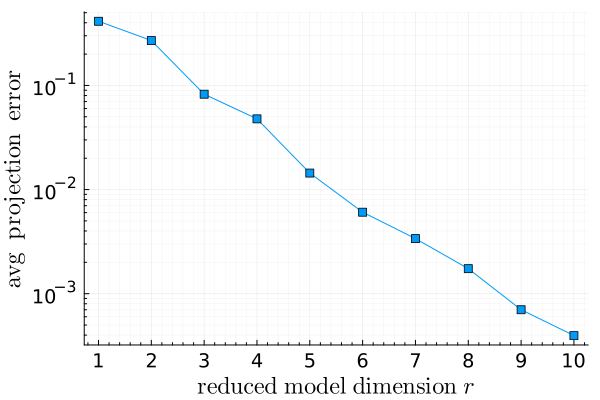

In [35]:
# Training data
mean_train_proj_err = mean(Data["train_proj_err"], dims=2)
plot(rmin:rmax, mean_train_proj_err, marker=(:rect))
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=false)
tmp = log10.(mean_train_proj_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~projection~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Mean relative state error

In [20]:
DataFrame(Data["train_state_err"][:LS], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.478593,0.446343,0.423131,0.405456,0.391351,0.379691
2,0.342925,0.309906,0.287784,0.27222,0.260927,0.252473
3,0.107861,0.094906,0.0883509,0.0843701,0.0816844,0.0797555
4,0.0681662,0.0575138,0.0521497,0.0488034,0.0464797,0.044767
5,0.0224314,0.0178253,0.0157784,0.014683,0.0140365,0.0136317
6,0.0119543,0.00823418,0.00656997,0.00565862,0.00510355,0.0047426
7,0.00568733,0.00440189,0.00388773,0.00363484,0.00349238,0.00339908
8,0.00332508,0.00235414,0.00198548,0.0018114,0.00171356,0.00164717
9,0.00135227,0.000956948,0.000815886,0.000749446,0.000714018,0.000684221


In [21]:
DataFrame(Data["train_state_err"][:int], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.478593,0.446343,0.423131,0.405456,0.391351,0.379691
2,0.342916,0.3099,0.28778,0.272218,0.260927,0.252474
3,0.107855,0.0949088,0.0883596,0.0843835,0.0817012,0.0797735
4,0.0681483,0.0575124,0.0521527,0.0488081,0.0464862,0.0447749
5,0.0224244,0.0178215,0.0157747,0.0146807,0.0140354,0.0136309
6,0.0119445,0.0082313,0.00656739,0.00565585,0.00510107,0.00474074
7,0.00568038,0.00439827,0.00388635,0.00363343,0.0034905,0.00339678
8,0.00331354,0.00234394,0.0019786,0.00180524,0.00170728,0.00164087
9,0.00133127,0.000942065,0.000801677,0.00073479,0.000697212,0.000673518


In [22]:
DataFrame(Data["train_state_err"][:ephec], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.478548,0.446302,0.4231,0.405433,0.391335,0.379679
2,0.343211,0.310539,0.288533,0.272964,0.261583,0.252998
3,0.106546,0.0944877,0.0881385,0.0842256,0.0815776,0.0796773
4,0.0669964,0.0569924,0.0518203,0.0485407,0.0462518,0.0445663
5,0.022166,0.017607,0.0155496,0.0144492,0.0138014,0.0133957
6,0.0117294,0.00818357,0.0065539,0.00564937,0.00509485,0.00473306
7,0.00560947,0.00436085,0.00385827,0.00360863,0.0034673,0.00337563
8,0.00324012,0.00231101,0.00195527,0.00178421,0.00168643,0.00161974
9,0.00133055,0.000946919,0.000805286,0.000736366,0.000696864,0.000671472


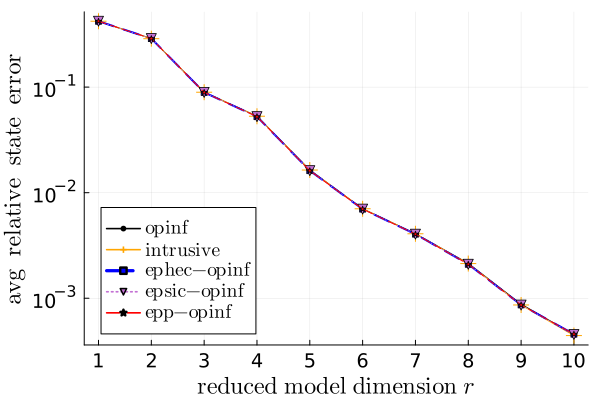

In [23]:
# Training data
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["train_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["train_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["train_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["train_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["train_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Total Energy

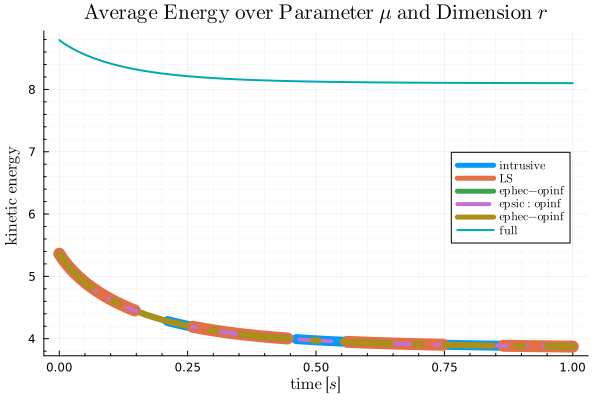

In [26]:
# Training data
mean_LS_En_tr = mean(Data["train_En"][:LS])'
mean_int_En_tr = mean(Data["train_En"][:int])'
mean_ephec_En_tr = mean(Data["train_En"][:ephec])'
mean_epsic_En_tr = mean(Data["train_En"][:epsic])'
mean_epp_En_tr = mean(Data["train_En"][:epp])'
mean_fom_En_tr = mean(Data["train_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:right)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

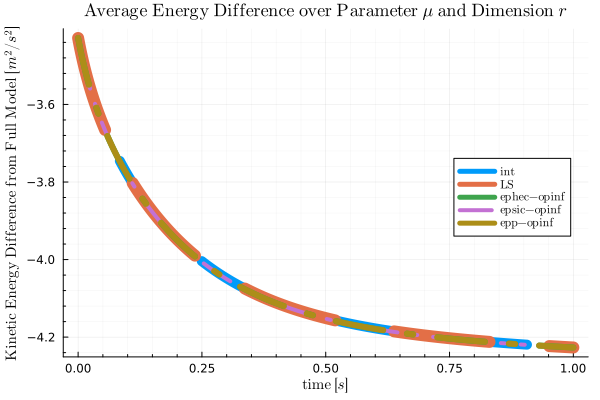

In [28]:
plot(burger.t, mean_int_En_tr - mean_fom_En_tr, lw=10, ls=:dash, label=L"\mathrm{int}")
plot!(burger.t, mean_LS_En_tr - mean_fom_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr - mean_fom_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epp_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(majorgrid=true, minorgrid=true, legend=:right)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{Kinetic~Energy~Difference~from~Full~Model}~[m^2/s^2]", fontsize=(8))
title!(L"\mathrm{Average~Energy~Difference~over~Parameter}~\mu \mathrm{~and~Dimension~} r", titlefont = font(12))
plot!(guidefontsize=10)

#### Constraint Residual 

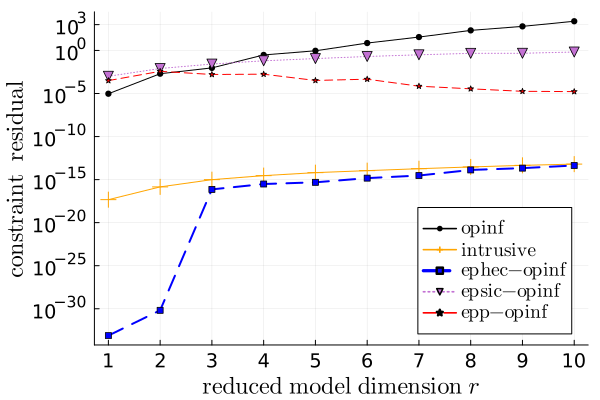

In [39]:
mean_LS_CR_tr = mean(Data["train_CR"][:LS], dims=2)
mean_int_CR_tr = mean(Data["train_CR"][:int], dims=2)
mean_ephec_CR_tr = mean(Data["train_CR"][:ephec], dims=2)
mean_epsic_CR_tr = mean(Data["train_CR"][:epsic], dims=2)
mean_epp_CR_tr = mean(Data["train_CR"][:epp], dims=2)
mean_fom_CR_tr = mean(Data["train_CR"][:fom])

plot(rmin:rmax, mean_LS_CR_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_CR_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_CR_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_CR_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_CR_tr, c=:red, marker=(:star, 3), ls=:dash, lw=1, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-30, -25, -20, -15, -10, -5, 0, 3])
xticks!(1:15)
xlabel!(L"\mathrm{reduced~model~dimension}~r")
ylabel!(L"\mathrm{constraint~~residual}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Momentum 

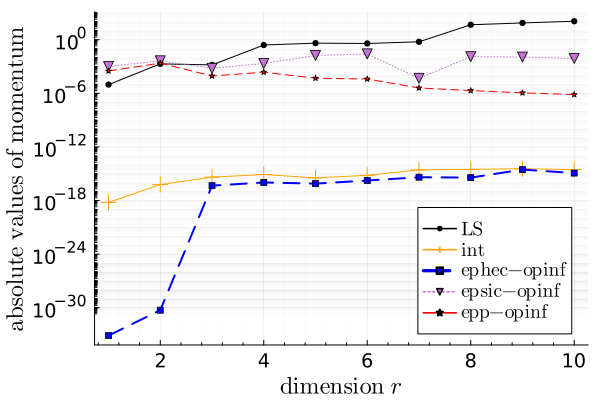

In [31]:
mean_LS_mmt_tr    = abs.(mean(Data["train_mmt"][:LS], dims=2))
mean_int_mmt_tr   = abs.(mean(Data["train_mmt"][:int], dims=2))
mean_ephec_mmt_tr = abs.(mean(Data["train_mmt"][:ephec], dims=2))
mean_epsic_mmt_tr = abs.(mean(Data["train_mmt"][:epsic], dims=2))
mean_epp_mmt_tr = abs.(mean(Data["train_mmt"][:epp], dims=2))
mean_fom_mmt_tr   = abs.(mean(Data["train_mmt"][:fom]))

plot(rmin:rmax, mean_LS_mmt_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{LS}")
plot!(rmin:rmax, mean_int_mmt_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{int}")
plot!(rmin:rmax, mean_ephec_mmt_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_mmt_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_mmt_tr, c=:red, marker=(:star, 3), ls=:dash, lw=1, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-30, -24, -18, -12, -6, 0, 6])
xlabel!(L"\mathrm{dimension}~r")
ylabel!(L"\mathrm{absolute~values~of~momentum}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Constraint Violation

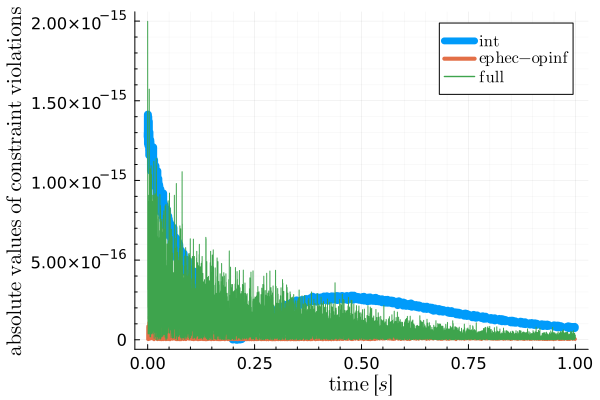

In [49]:
# Training data
mean_LS_CV_tr    = abs.(mean(Data["train_CV"][:LS]))'
mean_int_CV_tr   = abs.(mean(Data["train_CV"][:int]))'
mean_ephec_CV_tr = abs.(mean(Data["train_CV"][:ephec]))'
mean_epsic_CV_tr = abs.(mean(Data["train_CV"][:epsic]))'
mean_epp_CV_tr = abs.(mean(Data["train_CV"][:epp]))'
mean_fom_CV_tr   = abs.(mean(Data["train_CV"][:fom]))

plot(burger.t, mean_int_CV_tr, lw=8, ls=:dash, label=L"\mathrm{int}")
# plot!(burger.t, mean_LS_CV_tr, lw=6, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_CV_tr, lw=3, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epp_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_CV_tr, lw=1, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
# yticks!(10.0 .^ [-24, -21, -18, -15, -12, -9, -6, -3, 0])
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{absolute~values~of~constraint~violations}")
plot!(guidefontsize=14, tickfontsize=11,  legendfontsize=11)

## Test 1: Inside Training Region

In [60]:
# Load the data dictionary
_, Data["test1_state_err"], Data["test1_En"], _, _, _ = EP_analyze(Data,burger,options,Data["Xtest_in"],Data["IC_test_in"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60


Progress:  33%|██████████████                           |  ETA: 0:01:07

Progress:  50%|█████████████████████                    |  ETA: 0:00:50

Progress:  67%|████████████████████████████             |  ETA: 0:00:34

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:17

Progress: 100%|█████████████████████████████████████████| Time: 0:01:40


In [ ]:
@save filename Data

### Results

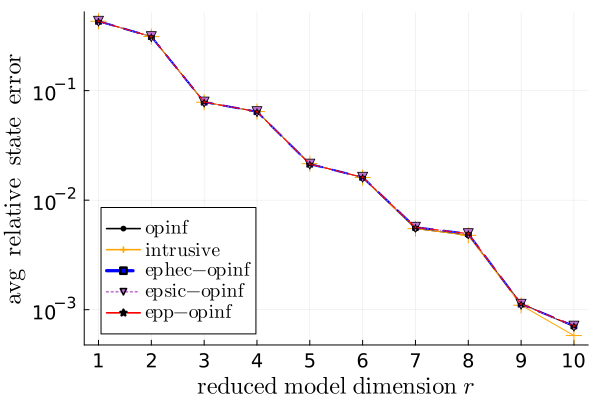

In [65]:
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["test1_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test1_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test1_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test1_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test1_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

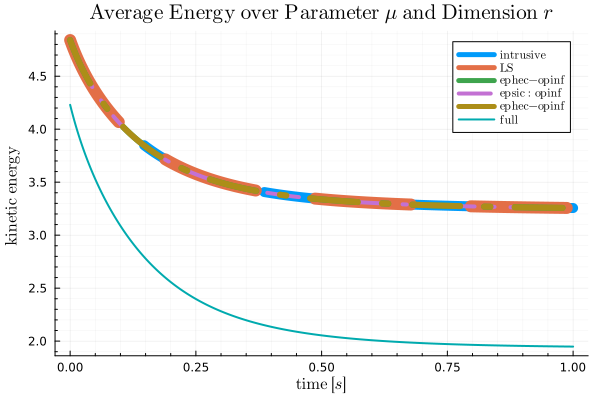

In [66]:
mean_LS_En_tr = mean(Data["test1_En"][:LS])'
mean_int_En_tr = mean(Data["test1_En"][:int])'
mean_ephec_En_tr = mean(Data["test1_En"][:ephec])'
mean_epsic_En_tr = mean(Data["test1_En"][:epsic])'
mean_epp_En_tr = mean(Data["test1_En"][:epp])'
mean_fom_En_tr = mean(Data["test1_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

## Test 2: Outside Training Region

In [62]:
# Load the data dictionary
_, Data["test2_state_err"], Data["test2_En"], _, _, _ = EP_analyze(Data,burger,options,Data["Xtest_out"],Data["IC_test_out"],rmin,rmax)
;

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60


Progress:  33%|██████████████                           |  ETA: 0:01:08

Progress:  50%|█████████████████████                    |  ETA: 0:00:51

Progress:  67%|████████████████████████████             |  ETA: 0:00:34

Progress:  83%|███████████████████████████████████      |  ETA: 0:00:17

Progress: 100%|█████████████████████████████████████████| Time: 0:01:41


([0.4209902820119219 0.3897450663340344 … 0.32657994283806996 0.31130898033489185; 0.30228994861092573 0.24683653962565444 … 0.15494108193660572 0.139244461725237; … ; 0.003403509179502319 0.0025719383048701193 … 0.0019006795821606096 0.0018184249731042982; 0.0026014265778298877 0.0017586977789222115 … 0.000876010845687342 0.0007610294079365731], Dict(:int => [0.4235268908411404 0.3929280038535595 … 0.3323329865928816 0.3179921215003029; 0.3736708050354028 0.29455738303366014 … 0.17589813845397895 0.15746342376413205; … ; 0.004257743380469177 0.0034144607486903816 … 0.00272527873805466 0.00265087254298278; 0.0031877954345436105 0.0023122841996764927 … 0.0013713950396570247 0.001250374893394168], :LS => [0.42352714353410315 0.3929279717920552 … 0.33233282527432767 0.3179919724372288; 0.3737630721231867 0.2946198623721619 … 0.17593007427165547 0.1574861860230214; … ; 0.004525713127227622 0.0034703963476825582 … 0.002731540787650813 0.002656809246805738; 0.0038719940237693664 0.0025911239

In [63]:
@save filename Data

### Results

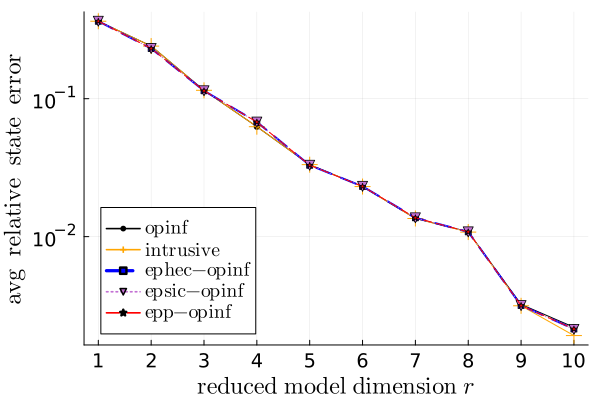

In [69]:
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = mean(Data["test2_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["test2_state_err"][:int], dims=2)
mean_ephec_state_err = mean(Data["test2_state_err"][:ephec], dims=2)
mean_epsic_state_err = mean(Data["test2_state_err"][:epsic], dims=2)
mean_epp_state_err = mean(Data["test2_state_err"][:epp], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epp_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epp}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)


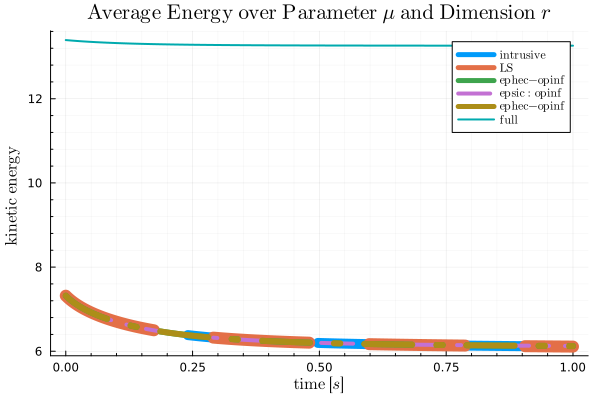

In [70]:
# Training data
mean_LS_En_tr = mean(Data["test2_En"][:LS])'
mean_int_En_tr = mean(Data["test2_En"][:int])'
mean_ephec_En_tr = mean(Data["test2_En"][:ephec])'
mean_epsic_En_tr = mean(Data["test2_En"][:epsic])'
mean_epp_En_tr = mean(Data["test2_En"][:epp])'
mean_fom_En_tr = mean(Data["test2_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
plot!(burger.t, mean_epp_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")